# 1: Calcolo dell'evapotraspirazione con il modello di Priestley - Taylor

L’evapotraspirazione è un processo che manifesta l’aumento di entropia nei processi in cui l’acqua cambia di fase, ad esempio da liquida a vapore nel caso di superfici d’acqua e suoli (EVAPORAZIONE) e per processi nei quali il cambio di fase avviene per mantenere l’equilibrio termico delle piante e degli animali (TRASPIRAZIONE). Si tratta, dunque, di un flusso di energia, acqua, vapore ed entropia, che avviene a causa della rottura dei legami a idrogeno nell’acqua liquida e della diffusione del vapore da zone a pressione parziale più elevata a zone a pressione parziale meno elevata, a causa della variazione della temperatura, secondo la legge di Dalton.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Image
import plotly.express as px
import os
import plotly.graph_objects as go
id = 2

## - Simfile modificato

import static oms3.SimBuilder.instance as OMS3
import static oms3.SimBuilder.*
def home = oms_prj

def startDate	= "2020-01-01 00:00"
def endDate		= "2022-01-01 00:00"
def site 		= "Cavone"
def timestep 	= 60
def ID			= 1

OMS3.sim {
	resource "$oms_prj/lib"    
	model(while:"readerAirTemperature.doProcess") {
		components {
			//Input-Output components
			"input"     "it.geoframe.blogspot.geoet.inout.InputReaderMain"
			"output"    "it.geoframe.blogspot.geoet.inout.OutputWriterMain"
			
			//GEOET components
			"priestleyTaylor"               "it.geoframe.blogspot.geoet.priestleytaylor.PriestleyTaylorActualETSolverMain"
			"PTstressfactor"				"it.geoframe.blogspot.geoet.stressfactor.solver.PTPMStressFactorSolverMain"
			
			"readerAirTemperature"			"org.hortonmachine.gears.io.timedependent.OmsTimeSeriesIteratorReader"
			"readerNetRadiation"            "org.hortonmachine.gears.io.timedependent.OmsTimeSeriesIteratorReader"
			"readerAtmosphericPressure"     "org.hortonmachine.gears.io.timedependent.OmsTimeSeriesIteratorReader"
			"readerSoilHeatFlux"          	"org.hortonmachine.gears.io.timedependent.OmsTimeSeriesIteratorReader"
			"readerSoilMoisture"          	"org.hortonmachine.gears.io.timedependent.OmsTimeSeriesIteratorReader"
			"readerCentroids"				"org.hortonmachine.gears.io.shapefile.OmsShapefileFeatureReader"		       
			"readerDem"						"org.hortonmachine.gears.io.rasterreader.OmsRasterReader" 	
			"writerLatentHeatPT"			"org.hortonmachine.gears.io.timedependent.OmsTimeSeriesIteratorWriter"      
			"writerETPriestleyTaylor"		"org.hortonmachine.gears.io.timedependent.OmsTimeSeriesIteratorWriter"      			         
			
			}  
			parameter{        
				
				// GEOgraphy PARAMETERS
				"readerDem.file"			"${home}/data/${site}/${ID}/dem_${ID}.tif"	 
				"readerCentroids.file"		"${home}/data/${site}/${ID}/centroids_ID_${ID}.shp"
				"input.idCentroids"			"ID"
				"input.centroidElevation"	"Elevation" 
				
				// PARAMETERS
				"priestleyTaylor.alpha"						1.26
		        "priestleyTaylor.soilFluxParameterDay"		0.35
		        "priestleyTaylor.soilFluxParameterNight"		0.75
        			"output.doPrintOutputPT"						true
        		
        
				//Parameters for the Radiation Stress
				"PTstressfactor.useRadiationStress" true
				  
				"PTstressfactor.alpha" 				0.005
				"PTstressfactor.theta" 				0.85
				
				//Parameter for the Vapour Pressure Deficit Stress
				"PTstressfactor.useVDPStress" true
				
				"PTstressfactor.VPD0" 				5.0 
				
				//Parameters for the Temperature Stress
				"PTstressfactor.useTemperatureStress" true    
				   	
				"PTstressfactor.Tl" 		"-5.0"
				"PTstressfactor.T0" 				20.0
				"PTstressfactor.Th" 				45.0 
				
				//Parameters for the Water Stress 
				"PTstressfactor.useWaterStress" false 
				     	
				"PTstressfactor.waterWiltingPoint"	0.06  
				"PTstressfactor.waterFieldCapacity"	0.18
				"PTstressfactor.depth"  				1.0
				"PTstressfactor.depletionFraction" 	0.4   
				"PTstressfactor.cropCoefficient" 	0.45 
        		
		        "input.temporalStep"	"${timestep}"
        		"input.tStartDate"		"${startDate}"
        		
        		// READERS
				"readerAirTemperature.file"         			"C:/Users/E580/Desktop/UNI/Idrologia/Esercitazione2/temp.csv"
				"readerAirTemperature.idfield"          		"ID"		
				"readerAirTemperature.tStart"           		"${startDate}"
				"readerAirTemperature.tEnd"         			"${endDate}"
				"readerAirTemperature.tTimestep"            	"${timestep}"
				"readerAirTemperature.fileNovalue"          	"-9999.0"       
				
				"readerNetRadiation.file"                       "C:/Users/E580/Desktop/UNI/Idrologia/Esercitazione2/Net_allsky_1.csv"
				"readerNetRadiation.idfield"                    "ID"
				"readerNetRadiation.tStart"                     "${startDate}"
				"readerNetRadiation.tEnd"                       "${endDate}"
				"readerNetRadiation.tTimestep"                  "${timestep}"
				"readerNetRadiation.fileNovalue"                "-9999.0"	
			
				"readerAtmosphericPressure.file"                "C:/Users/E580/Desktop/UNI/Idrologia/Esercitazione2/p_atm.csv"
				"readerAtmosphericPressure.idfield"             "ID"		
				"readerAtmosphericPressure.tStart"              "${startDate}"
				"readerAtmosphericPressure.tEnd"                "${endDate}"
				"readerAtmosphericPressure.tTimestep"           "${timestep}"
				"readerAtmosphericPressure.fileNovalue"         "-9999.0"  
				
				"readerSoilMoisture.file"         				"C:/Users/E580/Desktop/UNI/Idrologia/Esercitazione2/SoilMoisture.csv"
				"readerSoilMoisture.idfield"      				"ID"  
				"readerSoilMoisture.tStart"       				"${startDate}"
				"readerSoilMoisture.tEnd"         				"${endDate}"
				"readerSoilMoisture.tTimestep"    				"${timestep}"
				"readerSoilMoisture.fileNovalue"  				"-9999.0"     
				
				"readerSoilHeatFlux.file"                       "C:/Users/E580/Desktop/UNI/Idrologia/Esercitazione2/GHF_9999.csv"
                "readerSoilHeatFlux.idfield"                    "ID"		
                "readerSoilHeatFlux.tStart"                     "${startDate}"
                "readerSoilHeatFlux.tEnd"                       "${endDate}"
                "readerSoilHeatFlux.tTimestep"                  "${timestep}"
                "readerSoilHeatFlux.fileNovalue"                "-9999.0"                                                     
			
				// WRITERS
				"writerLatentHeatPT.file"						"C:/Users/E580/Desktop/UNI/Idrologia/Esercitazione2/LatentHeat_PT_3.csv"
				"writerLatentHeatPT.tStart"						"${startDate}"
				"writerLatentHeatPT.tTimestep"					"${timestep}"
				
				"writerETPriestleyTaylor.file"					"C:/Users/E580/Desktop/UNI/Idrologia/Esercitazione2/Evapotranspiration_PT_2.csv"
				"writerETPriestleyTaylor.tStart"				"${startDate}"
				"writerETPriestleyTaylor.tTimestep"				"${timestep}"
				}
				
				
				connect { 
				"input.doProcess"                   	"priestleyTaylor.doProcess"
				"input.doProcess"                   	"PTstressfactor.doProcess"  
				"priestleyTaylor.doProcessOut"          "output.doProcessOut"	               
				"readerAirTemperature.outData"			"input.inAirTemperature"
				"readerNetRadiation.outData"			"input.inNetRadiation"
				"readerAtmosphericPressure.outData"		"input.inAtmosphericPressure"	
				"readerSoilHeatFlux.outData"			"input.inSoilFlux"	
				"readerCentroids.geodata"				"input.inCentroids"
				"readerDem.outRaster"					"input.inDem" 	
				"PTstressfactor.stressSun"				"priestleyTaylor.stressFactor"
				"output.outLatentHeatPT"				"writerLatentHeatPT.inData"
				"output.outEvapoTranspirationPT"   		"writerETPriestleyTaylor.inData"
				}					
			}
	}

# Evapotraspirazione potenziale

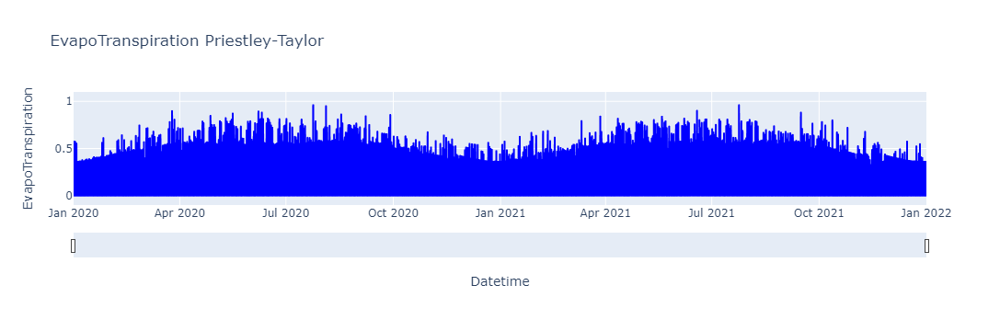

In [2]:
pot = pd.read_csv('PotentialEvapotranspiration_PT_'+str(id)+'.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
pot.columns = ['Datetime','EvapoTranspiration']
fig = px.line(pot, x='Datetime', y='EvapoTranspiration', title='EvapoTranspiration Priestley-Taylor')
fig.update_layout(yaxis_range=[-0.1, 1.1])
fig.update_traces(line_color='blue')
fig.update_xaxes(rangeslider_visible=True)
fig.show()

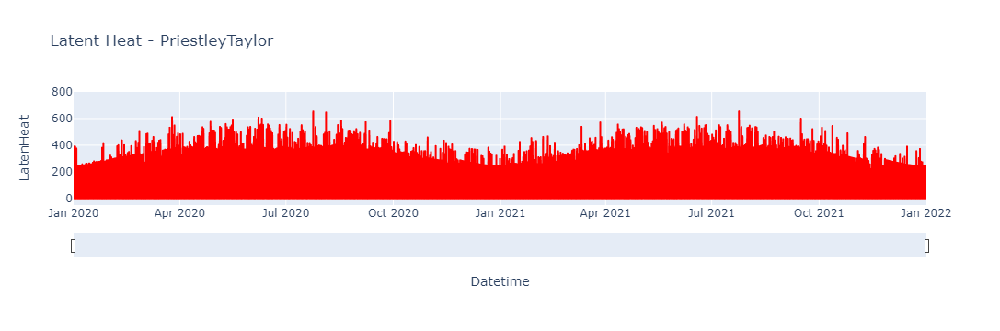

In [3]:
pot_lh = pd.read_csv('PotentialLatentHeat_PT_'+str(id)+'.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
pot_lh.columns = ['Datetime','LatenHeat']
fig = px.line(pot_lh, x='Datetime', y='LatenHeat', title='Latent Heat - PriestleyTaylor')
fig.update_layout(yaxis_range=[-50, 800])
fig.update_traces(line_color='red')
fig.update_xaxes(rangeslider_visible=True)
fig.show()

# Evapotraspirazione effettiva

## Radiation Stress

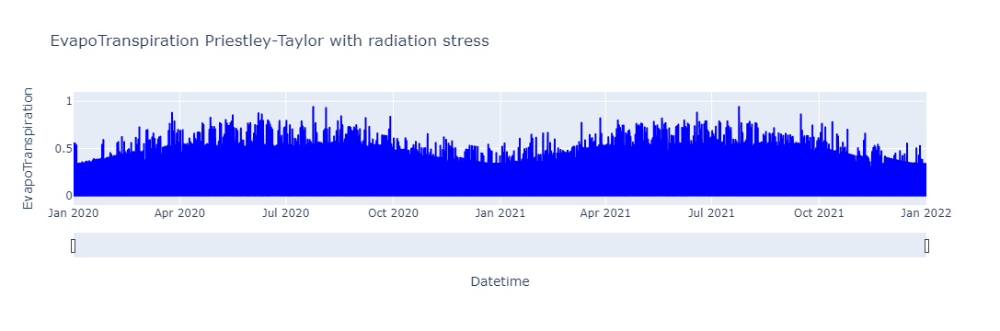

In [4]:
rad = pd.read_csv('RadiationEvapotranspiration_PT_'+str(id)+'.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
rad.columns = ['Datetime','EvapoTranspiration']
fig = px.line(rad, x='Datetime', y='EvapoTranspiration', title='EvapoTranspiration Priestley-Taylor with radiation stress')
fig.update_layout(yaxis_range=[-0.1, 1.1])
fig.update_traces(line_color='blue')
fig.update_xaxes(rangeslider_visible=True)
fig.show()

## Vapour Pressure Deficit Stress

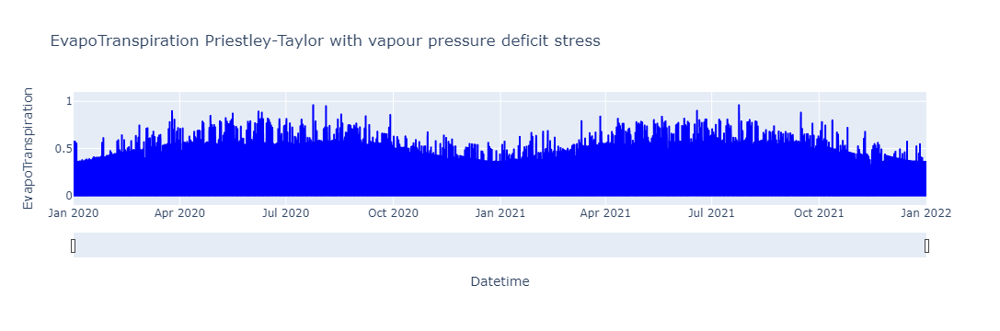

In [5]:
vap = pd.read_csv('VapourPressureEvapotranspiration_PT_'+str(id)+'.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
vap.columns = ['Datetime','EvapoTranspiration']
fig = px.line(vap, x='Datetime', y='EvapoTranspiration', title='EvapoTranspiration Priestley-Taylor with vapour pressure deficit stress')
fig.update_layout(yaxis_range=[-0.1, 1.1])
fig.update_traces(line_color='blue')
fig.update_xaxes(rangeslider_visible=True)
fig.show()

## Temperature Stress

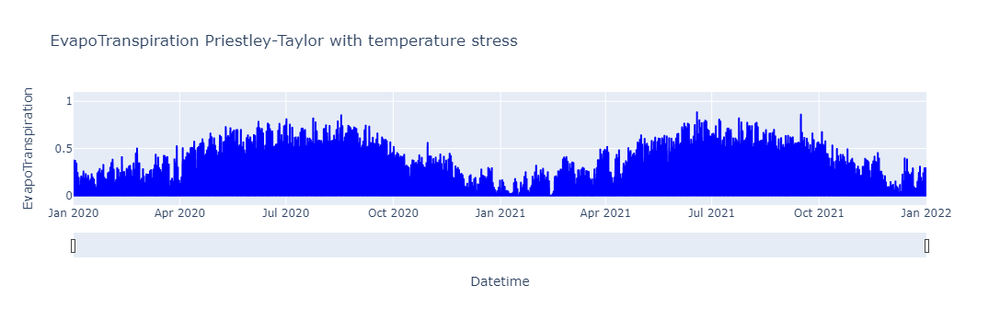

In [6]:
temp = pd.read_csv('TemperatureEvapotranspiration_PT_'+str(id)+'.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
temp.columns = ['Datetime','EvapoTranspiration']
fig = px.line(temp, x='Datetime', y='EvapoTranspiration', title='EvapoTranspiration Priestley-Taylor with temperature stress')
fig.update_layout(yaxis_range=[-0.1, 1.1])
fig.update_traces(line_color='blue')
fig.update_xaxes(rangeslider_visible=True)
fig.show()

## Water Stress

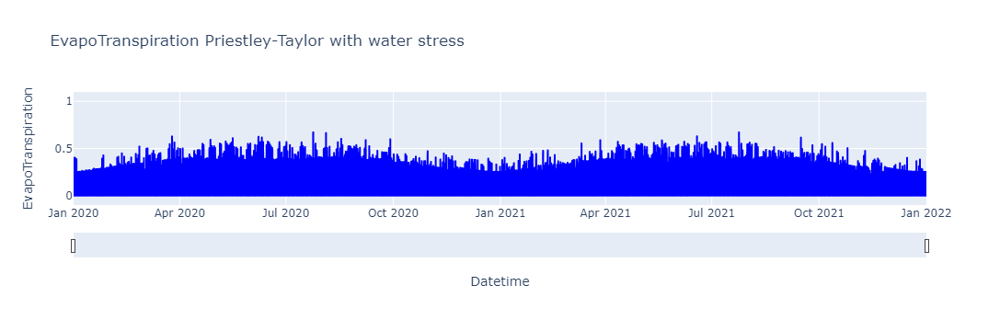

In [7]:
wat = pd.read_csv('WaterEvapotranspiration_PT_'+str(id)+'.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
wat.columns = ['Datetime','EvapoTranspiration']
fig = px.line(wat, x='Datetime', y='EvapoTranspiration', title='EvapoTranspiration Priestley-Taylor with water stress')
fig.update_layout(yaxis_range=[-0.1, 1.1])
fig.update_traces(line_color='blue')
fig.update_xaxes(rangeslider_visible=True)
fig.show()

## Actual Evapotranspiration

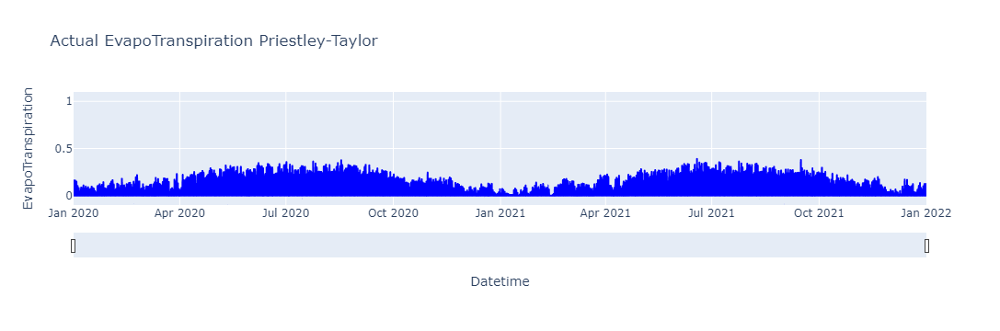

In [8]:
act = pd.read_csv('ActualEvapotranspiration_PT_'+str(id)+'.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
act.columns = ['Datetime','EvapoTranspiration']
fig = px.line(act, x='Datetime', y='EvapoTranspiration', title='Actual EvapoTranspiration Priestley-Taylor')
fig.update_layout(yaxis_range=[-0.1, 1.1])
fig.update_traces(line_color='blue')
fig.update_xaxes(rangeslider_visible=True)
fig.show()

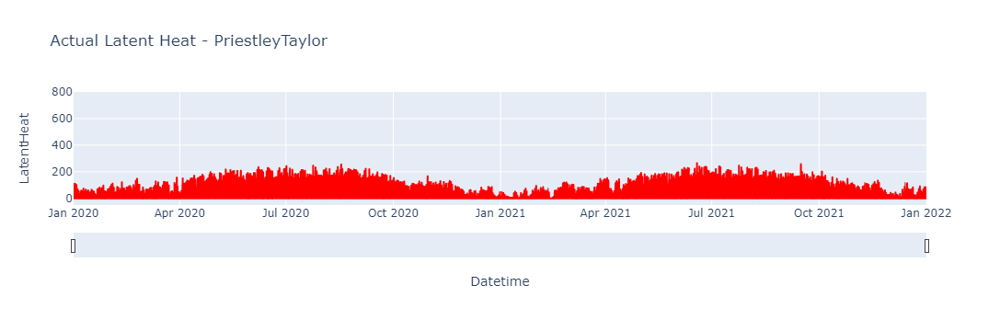

In [9]:
act_lh = pd.read_csv('ActualLatentHeat_PT_'+str(id)+'.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
act_lh.columns = ['Datetime','LatentHeat']
fig = px.line(act_lh, x='Datetime', y='LatentHeat', title='Actual Latent Heat - PriestleyTaylor')
fig.update_layout(yaxis_range=[-50, 800])
fig.update_traces(line_color='red')
fig.update_xaxes(rangeslider_visible=True)
fig.show()

## Stress applicati uno dopo l'altro

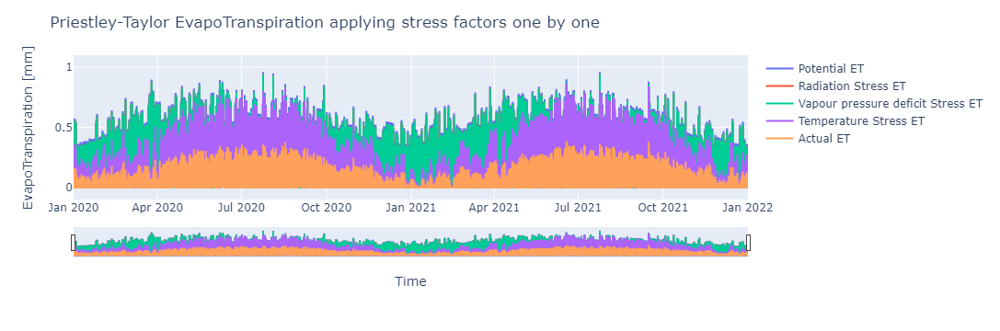

In [10]:
stress1 = pd.read_csv('Stress1Evapotranspiration_PT_2.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
stress1.columns = ['Datetime','EvapoTranspiration']
stress2 = pd.read_csv('Stress2Evapotranspiration_PT_2.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
stress2.columns = ['Datetime','EvapoTranspiration']
stress3 = pd.read_csv('Stress3Evapotranspiration_PT_2.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
stress3.columns = ['Datetime','EvapoTranspiration']

fig = px.line()
fig.add_trace(go.Scatter(x=pot['Datetime'], y=pot['EvapoTranspiration'], mode='lines', name='Potential ET'))
fig.add_trace(go.Scatter(x=stress1['Datetime'], y=stress1['EvapoTranspiration'], mode='lines', name='Radiation Stress ET'))
fig.add_trace(go.Scatter(x=stress2['Datetime'], y=stress2['EvapoTranspiration'], mode='lines', name='Vapour pressure deficit Stress ET'))
fig.add_trace(go.Scatter(x=stress3['Datetime'], y=stress3['EvapoTranspiration'], mode='lines', name='Temperature Stress ET'))
fig.add_trace(go.Scatter(x=act['Datetime'], y=act['EvapoTranspiration'], mode='lines', name='Actual ET'))

fig.update_layout(
    title='Priestley-Taylor EvapoTranspiration applying stress factors one by one',
    xaxis_title="Time",
    yaxis_title="EvapoTranspiration [mm]",)
fig.update_layout(yaxis_range=[-0.1, 1.1])
fig.update_xaxes(rangeslider_visible=True)
fig.show()

Il grafico mostra come gli stress relativi alla temperatura e al contenunto d'acqua siano i più significativi nel ridurre l'entità dall'evapotraspirazione.